In [1]:
import tellurium as te
import importlib
import os
import glob
from pathlib import Path
import pandas as pd
from pandas.api.types import CategoricalDtype
import matplotlib.pyplot as plt
from xlink_kme_sbml.library import sbml_sim_helper
from xlink_kme_sbml.library import sbml_constants as const
import altair as alt
import seaborn as sns
import numpy as np
import common_funcs as cf
from collections import defaultdict

In [2]:
# png for direct png output, works offline
# mimetype for native jupyterlab output, works offline
# html for the default renderer, works only online
# alt.renderers.enable('png') # enable offline rendering; will default to using notebook background color in the notebook but not when saving
alt.renderers.enable('html') 

RendererRegistry.enable('html')

In [3]:
alt.data_transformers.enable("vegafusion")

DataTransformerRegistry.enable('vegafusion')

In [4]:
# make altair fast and define mimetype here
# supports vega, svg, png
# import vegafusion as vf
# vf.enable(mimetype='html')

In [5]:
def order_by_prot_size(df):
    prot_ordered_list = ["Eg5", "Luci", "C3", "RNAP", "IFTA", "26S"]
    cat_type = CategoricalDtype(categories=prot_ordered_list,
                                ordered=True)
    df[const.S_EXP] = df[const.S_EXP].astype(cat_type)


In [6]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from '/home/kai/Nextcloud-unikn/Coding/xlink_kme_sbml/xlink_kme_sbml/library/sbml_sim_helper.py'>

# Settings

In [7]:
min_val = 0.05
sim_points = 100

# Input

Read Simulation Dataframes

In [8]:
path_input = "./paper_out/"
path_1d = os.path.join(path_input + "sim_1d/")
path_1d_no_hydro = os.path.join(path_input + "sim_1d/no_hydro/")
path_1d_const_conc = os.path.join(path_input + "sim_1d/const_conc/")
path_2d = os.path.join(path_input + "sim_2d/")
path_3d = os.path.join(path_input + "sim_3d/")
path_supp = os.path.join(path_input + "suppression_exp/")

## 1D

In [9]:
path_list_1d_mono_only_last_frame = glob.glob(path_1d + "mono-only-last-frame*.csv")
path_list_1d_mono_only_timeline = glob.glob(path_1d + "mono-only-timeline*.csv")

In [10]:
path_list_1d_last_frame = glob.glob(path_1d + "full-last-frame*.csv")
path_list_1d_timeline = glob.glob(path_1d + "full-timeline*.csv")
path_list_1d_last_frame_no_hydro = glob.glob(path_1d_no_hydro + "full-last-frame*.csv")
path_list_1d_timeline_no_hydro = glob.glob(path_1d_no_hydro + "full-timeline*.csv")
path_list_1d_last_frame_const_conc = glob.glob(path_1d_const_conc + "full-last-frame*.csv")
path_list_1d_timeline_const_conc = glob.glob(path_1d_const_conc + "full-timeline*.csv")

In [11]:
df_1d_mono_only_last_frame = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_mono_only_last_frame).reset_index(drop=True)
order_by_prot_size(df_1d_mono_only_last_frame)
len(df_1d_mono_only_last_frame)

6178

In [12]:
df_1d_mono_only_timeline = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_mono_only_timeline).reset_index(drop=True)
order_by_prot_size(df_1d_mono_only_timeline)
len(df_1d_mono_only_timeline)

617800

In [13]:
df_1d_last_frame = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_last_frame).reset_index(drop=True)
order_by_prot_size(df_1d_last_frame)
len(df_1d_last_frame)

11923

In [14]:
df_1d_timeline = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_timeline).reset_index(drop=True)
order_by_prot_size(df_1d_timeline)
len(df_1d_timeline)

1192300

In [15]:
df_1d_last_frame_no_hydro = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_last_frame_no_hydro).reset_index(drop=True)
order_by_prot_size(df_1d_last_frame_no_hydro)
len(df_1d_last_frame_no_hydro)

11923

In [16]:
df_1d_timeline_no_hydro = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_timeline_no_hydro).reset_index(drop=True)
order_by_prot_size(df_1d_timeline_no_hydro)
len(df_1d_timeline_no_hydro)

1192300

In [17]:
df_1d_last_frame_const_conc = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_last_frame_const_conc).reset_index(drop=True)
df_1d_last_frame_const_conc[const.S_VALUE_SCALED] = df_1d_last_frame_const_conc[const.S_VALUE] / 5.5e-6
order_by_prot_size(df_1d_last_frame_const_conc)
len(df_1d_last_frame_const_conc)

11923

In [18]:
df_1d_timeline_const_conc = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_1d_timeline_const_conc).reset_index(drop=True)
df_1d_timeline_const_conc[const.S_VALUE_SCALED] = df_1d_timeline_const_conc[const.S_VALUE] / 5.5e-6
order_by_prot_size(df_1d_timeline_const_conc)
len(df_1d_timeline_const_conc)

1192300

In [19]:
df_1d_timeline_26S_only = df_1d_timeline.loc[df_1d_timeline[const.S_EXP] == '26S']
df_1d_timeline_26S_only[cf.str_cond] = 'Hydrolysis'
df_1d_timeline_no_hydro_26S_only = df_1d_timeline_no_hydro[df_1d_timeline_no_hydro[const.S_EXP] == '26S']
df_1d_timeline_no_hydro_26S_only[cf.str_cond] = 'No Hydrolysis'
df_1d_timeline_26S_only = pd.concat([df_1d_timeline_26S_only, df_1d_timeline_no_hydro_26S_only]).reset_index(drop=True)


/tmp/ipykernel_1055723/2219687556.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1055723/2219687556.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## 2D

In [20]:
path_list_2d = glob.glob(path_2d + "*.csv")
df_dict_2d_all = defaultdict(list)
df_dict_2d_concat = defaultdict(lambda: "NotFound")
for p in path_list_2d:
    df = pd.read_csv(p, low_memory=False)
    file_name = Path(p).stem
    var_name = file_name.split('-')[1]
    df_dict_2d_all[var_name].append(df)

for var_name in df_dict_2d_all:
    df_concat = pd.concat(df_dict_2d_all[var_name]).reset_index(drop=True)
    order_by_prot_size(df_concat)
    df_dict_2d_concat[var_name] = df_concat

# 3D

In [21]:
path_list_3d = glob.glob(path_3d + "*.csv")
df_dict_3d_all = defaultdict(list)
df_dict_3d_concat = defaultdict(lambda: "NotFound")
for p in path_list_3d:
    df = pd.read_csv(p, low_memory=False)
    file_name = Path(p).stem
    exp_name = file_name.split('-')[-1].replace(".csv","")
    var_name_1, var_name_2 = file_name.split('-')[1:3]
    df_dict_3d_all[f"{exp_name}-{var_name_1}-{var_name_2}"].append(df)

for name in df_dict_3d_all:
    df_concat = pd.concat(df_dict_3d_all[name]).reset_index(drop=True)
    # order_by_prot_size(df_concat)
    exp_name, var_name_1, var_name_2 = name.split('-')
    df_dict_3d_concat[f"{exp_name}-{var_name_1}-{var_name_2}"] = df_concat
    df_dict_3d_concat[f"{exp_name}-{var_name_2}-{var_name_1}"] = df_concat

def get_3d_df_concat(exp_name, var_name_1, var_name_2):
    return df_dict_3d_concat[f"{exp_name}-{var_name_1}-{var_name_2}"]

# Supp Exp

In [22]:
path_list_supp = glob.glob(path_supp + "suppress*.csv")

In [23]:
df_supp_klys = pd.concat(pd.read_csv(f, low_memory=False) for f in path_list_supp).reset_index(drop=True)
# order_by_prot_size(df_supp_klys)
len(df_supp_klys)

429729

# Output

In [24]:
path_viz = os.path.join(path_input + "viz")
path_qc = f"{path_viz}/quality_control/"
path_gp = f"{path_viz}/general_parameters/"
path_ar = f"{path_viz}/absolute_results/"
path_surface = f"{path_viz}/parameter_surface/"
path_se = f"{path_viz}/suppression_experiment/"
path_chx = f"{path_viz}/chimerax_color_scripts/"

list_all_output_dirs = [path_qc, path_ar, path_gp, path_se, path_chx]

In [25]:
for d in list_all_output_dirs:
    os.makedirs(d, exist_ok=True)

# Quality Control

Check the distribution of crosslink and monolink values

When do mono- and crosslinked species converge?

In [24]:
# filter for mono and crosslinks
filter_mono_xl_timeline = df_1d_timeline[cf.str_type].str.fullmatch(f'{cf.str_species_mono_sum}|{cf.str_species_crosslinked}')
filter_mono_xl_last_frame = df_1d_last_frame[cf.str_type].str.fullmatch(f'{cf.str_species_mono_sum}|{cf.str_species_crosslinked}')

In [28]:
df_1d_timeline

,time,variable,value,type,Protein1,Chain_ID1,Pos1,Protein2,Chain_ID2,Pos2,rate_const,value_scaled,exp
0,0.000000,Crosslinker,2.863850e-04,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,374.500000,26S
1,3030.303030,Crosslinker,1.396136e-04,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,182.569903,26S
2,6060.606061,Crosslinker,7.940236e-05,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,103.832905,26S
3,9090.909091,Crosslinker,4.918232e-05,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,64.314753,26S
4,12121.212121,Crosslinker,3.213265e-05,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,42.019234,26S
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1192295,300000.000000,MonoSum_P62487_G_94,8.115303e-07,MonoSum,P62487,G,94.0,NaN,NaN,NaN,0.395043,0.424629,RNAP
1192296,300000.000000,MonoSum_P62875_J_12,3.742523e-07,MonoSum,P62875,J,12.0,NaN,NaN,NaN,0.203605,0.195825,RNAP
1192297,300000.000000,MonoSum_P62875_J_17,4.012848e-07,MonoSum,P62875,J,17.0,NaN,NaN,NaN,0.225982,0.209970,RNAP
1192298,300000.000000,MonoSum_P62875_J_41,2.720669e-07,MonoSum,P62875,J,41.0,NaN,NaN,NaN,0.499410,0.142357,RNAP


In [58]:
# group by every distinct species and calculate the rolling standard deviation value for a window size of sim_points/10
df_converge = df_1d_timeline[filter_mono_xl_timeline].groupby([const.S_EXP, cf.str_type, cf.str_var])[[cf.str_time, cf.str_value, const.S_VALUE_SCALED]].rolling(window=int(np.floor(sim_points/10)), on=cf.str_time).std().reset_index(drop=False)
df_converge

,exp,type,variable,level_3,time,value,value_scaled
0,Eg5,MonoSum,MonoSum_P52732_A_146,705100,0.000000,NaN,NaN
1,Eg5,MonoSum,MonoSum_P52732_A_146,705121,3030.303030,NaN,NaN
2,Eg5,MonoSum,MonoSum_P52732_A_146,705142,6060.606061,NaN,NaN
3,Eg5,MonoSum,MonoSum_P52732_A_146,705163,9090.909091,NaN,NaN
4,Eg5,MonoSum,MonoSum_P52732_A_146,705184,12121.212121,NaN,NaN
...,...,...,...,...,...,...,...
728495,26S,XL,XL_Q12377_Q_98_Q12377_Q_257,462295,287878.787879,3.498152e-16,4.578710e-10
728496,26S,XL,XL_Q12377_Q_98_Q12377_Q_257,462296,290909.090909,2.902735e-16,3.800964e-10
728497,26S,XL,XL_Q12377_Q_98_Q12377_Q_257,462297,293939.393939,2.415115e-16,3.164344e-10
728498,26S,XL,XL_Q12377_Q_98_Q12377_Q_257,462298,296969.696970,2.000588e-16,2.623546e-10


In [ ]:
# calculate the mean std grouped by every time point
df_converge_rolling_std = df_converge.groupby([const.S_EXP, cf.str_type, cf.str_time])[[cf.str_value, const.S_VALUE_SCALED]].mean().reset_index()
df_converge_rolling_std


,exp,type,time,value,value_scaled
0,Eg5,MonoSum,0.00000,NaN,NaN
1,Eg5,MonoSum,1010.10101,NaN,NaN
2,Eg5,MonoSum,2020.20202,NaN,NaN
3,Eg5,MonoSum,3030.30303,NaN,NaN
4,Eg5,MonoSum,4040.40404,NaN,NaN
...,...,...,...,...,...
1195,26S,XL,95959.59596,6.713807e-11,0.000088
1196,26S,XL,96969.69697,6.439438e-11,0.000084
1197,26S,XL,97979.79798,6.176868e-11,0.000081
1198,26S,XL,98989.89899,5.925561e-11,0.000077


What is the highest std among all species at the final time point?
Check that it is well below 0

In [ ]:
filter_max_time = df_converge[cf.str_time] == df_converge[cf.str_time].max()
df_converge[filter_max_time].groupby([const.S_EXP, cf.str_type])[[cf.str_value, const.S_VALUE_SCALED]].max()

value  value_scaled
exp  type                               
Eg5  MonoSum  5.784203e-09      0.000248
     XL       7.263172e-09      0.000311
Luci MonoSum  4.103293e-09      0.000502
     XL       4.447142e-09      0.000544
C3   MonoSum  2.705055e-09      0.000498
     XL       4.442262e-09      0.000818
RNAP MonoSum  8.217149e-10      0.000430
     XL       2.231445e-09      0.001168
IFTA MonoSum  8.232197e-10      0.000631
     XL       1.413092e-09      0.001083
26S  MonoSum  4.912275e-10      0.000642
     XL       8.231283e-10      0.001076

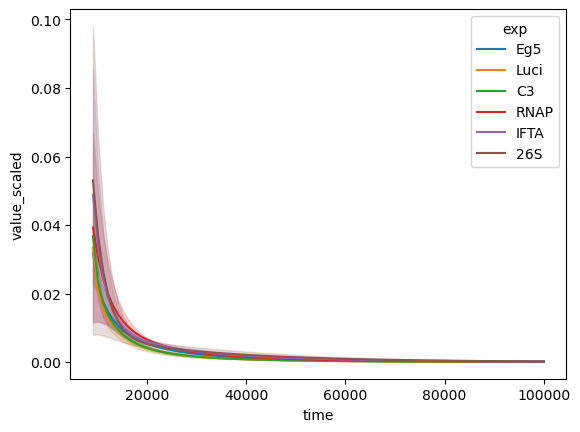

In [ ]:
sns.lineplot(data=df_converge_rolling_std, x=cf.str_time, y=const.S_VALUE_SCALED, hue=const.S_EXP)
plt.savefig(f"{path_qc}/monolink_crosslink_convergence_std.png", dpi=300)

In [105]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from 'C:\\Nextcloud-unikn\\Coding\\xlink_kme_sbml\\xlink_kme_sbml\\library\\sbml_sim_helper.py'>

Has the leftover crosslinker completely hydrolyzed?

In [25]:
c = cf.get_val_plot(df_1d_last_frame, species=cf.str_species_crosslinker, min_val=0, fullmatch=False, val_col=const.S_VALUE_SCALED)
c.save(f"{path_qc}/xl_consumption.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [260]:
c = cf.get_signi_plot(df_1d_last_frame, min_val_abs=min_val, val_col=const.S_VALUE_SCALED)
c.save(f"{path_qc}/significant_count.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [261]:
c = cf.get_signi_plot(df_1d_last_frame_no_hydro, min_val_abs=min_val, val_col=const.S_VALUE_SCALED)
c.save(f"{path_qc}/significant_count_no_hydro.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [262]:
c = cf.get_signi_plot(df_1d_last_frame, min_val_abs=min_val, val_col=const.S_VALUE_SCALED, metric='sum', show_signi_only=True)
c.save(f"{path_qc}/significant_sum.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [263]:
c = cf.get_signi_plot(df_1d_last_frame_no_hydro, min_val_abs=min_val, val_col=const.S_VALUE_SCALED, metric='sum', show_signi_only=True)
c.save(f"{path_qc}/significant_sum_no_hydro.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [123]:
c = cf.get_signi_plot(df_1d_last_frame_const_conc, min_val_abs=min_val, val_col=const.S_VALUE_SCALED, metric='sum', show_signi_only=True)
c.save(f"{path_qc}/significant_sum_const_conc.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [26]:
c = cf.get_signi_plot(df_1d_last_frame_const_conc, min_val_abs=min_val, val_col=const.S_VALUE_SCALED, metric='count', show_signi_only=True)
c.save(f"{path_qc}/significant_count_const_conc.png", scale_factor=2.0)
c

alt.FacetChart(...)

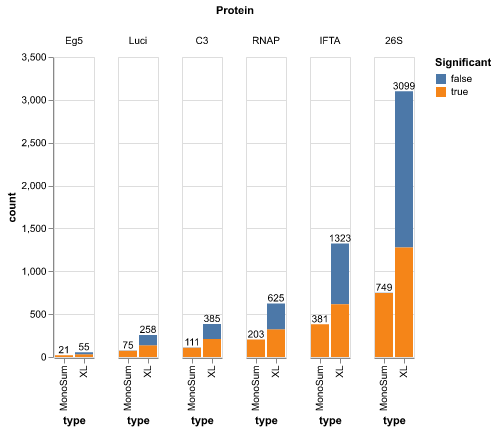

In [65]:
c = cf.get_signi_plot(df_1d_last_frame, min_val_abs=min_val, val_col=const.S_VALUE_SCALED, show_signi_only=False)
c.save(f"{path_qc}/significant_count_all.png", scale_factor=2.0)
c

In [66]:
df_1d_timeline[(df_1d_timeline[cf.str_time] == 0) & (df_1d_timeline[cf.str_type] == cf.str_species_crosslinker)]

,time,variable,value,type,Protein1,Chain_ID1,Pos1,Protein2,Chain_ID2,Pos2,rate_const,value_scaled,exp
0,0.0,Crosslinker,0.000286,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,374.5,26S
609800,0.0,Crosslinker,0.000301,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,55.5,C3
693000,0.0,Crosslinker,0.000245,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,10.5,Eg5
707200,0.0,Crosslinker,0.000249,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,190.5,IFTA
992200,0.0,Crosslinker,0.000307,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,37.5,Luci
1048300,0.0,Crosslinker,0.000194,Crosslinker,NaN,NaN,NaN,NaN,NaN,NaN,0.000025,101.5,RNAP


In [94]:
c = cf.get_signi_plot_line(df_1d_last_frame, min_val=0.05, val_col=const.S_VALUE_SCALED, metric='mean')
#c.save(f"{path_qc}/significant_sum.png", scale_factor=2.0)
c

alt.Chart(...)

In [90]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from 'C:\\Nextcloud-unikn\\Coding\\xlink_kme_sbml\\xlink_kme_sbml\\library\\sbml_sim_helper.py'>

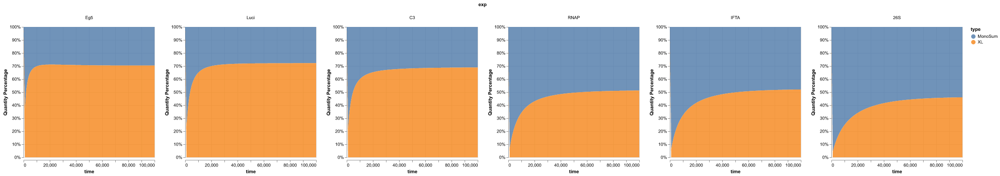

In [68]:
c = cf.get_area_plot_time(df_1d_timeline, fullmatch=True, species=f'{cf.str_species_mono_sum}|{cf.str_species_crosslinked}', column=const.S_EXP, val_col=const.S_VALUE, color=cf.str_type, metric='sum')
c.save(f"{path_qc}/species_percentage_timeline.png", scale_factor=2.0)
c

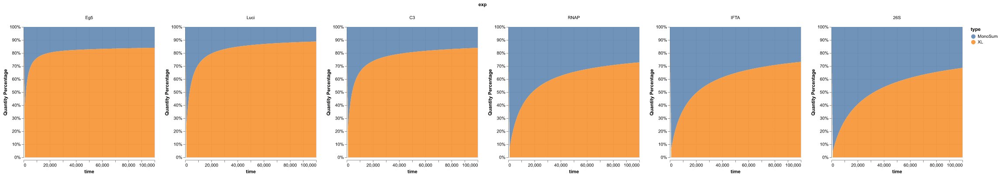

In [69]:
c = cf.get_area_plot_time(df_1d_timeline_no_hydro, fullmatch=True, species=f'{cf.str_species_mono_sum}|{cf.str_species_crosslinked}', column=const.S_EXP, val_col=const.S_VALUE, color=cf.str_type, metric='sum')
c.save(f"{path_qc}/species_percentage_timeline_no_hydro.png", scale_factor=2.0)
c

In [76]:
c = cf.get_area_plot_time(df_1d_timeline_26S_only, fullmatch=True, species=f'{cf.str_species_mono_sum}|{cf.str_species_crosslinked}', column=cf.str_cond, val_col=const.S_VALUE, color=cf.str_type, metric='sum')
c.save(f"{path_qc}/species_percentage_timeline_26S.png", scale_factor=2.0)
c

alt.FacetChart(...)

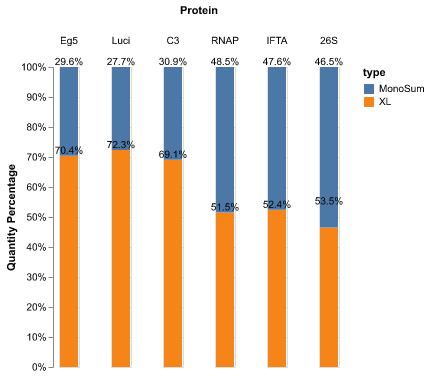

In [70]:
c = cf.get_val_percentage_plot(df_1d_last_frame, species=f"{cf.str_species_mono_sum}|{cf.str_species_crosslinked}", fullmatch=True, val_col=const.S_VALUE)
c.save(f"{path_qc}/species_percentage.png", scale_factor=2.0)
c

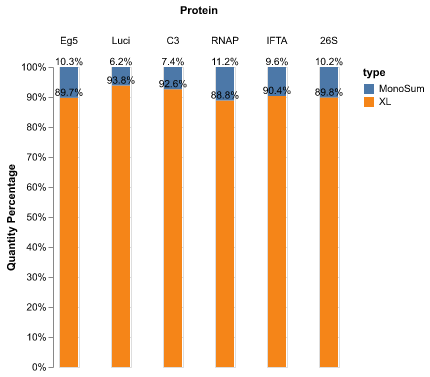

In [72]:
c = cf.get_val_percentage_plot(df_1d_last_frame_no_hydro, species=f"{cf.str_species_mono_sum}|{cf.str_species_crosslinked}", fullmatch=True, val_col=const.S_VALUE_SCALED)
c.save(f"{path_qc}/species_percentage_no_hydro.png", scale_factor=2.0)
c

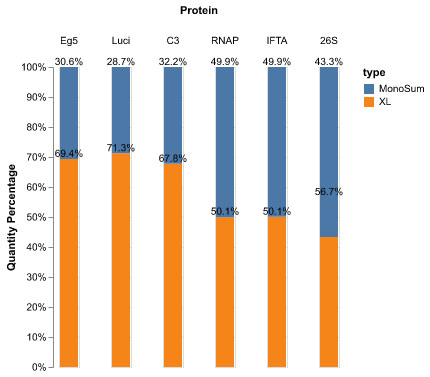

In [73]:
c = cf.get_val_percentage_plot(df_1d_last_frame, species=f"{cf.str_species_mono_sum}|{cf.str_species_crosslinked}", fullmatch=True, val_col=const.S_VALUE_SCALED, min_val=0.05)
c.save(f"{path_qc}/species_percentage_scaled_signi_only.png", scale_factor=2.0)
c

In [265]:
df_xl_fraction = cf.get_xl_fraction_df([df_1d_last_frame, df_1d_last_frame_const_conc, df_1d_last_frame_no_hydro], cond_list=["Const. Mass Conc.", "Const. Molar Conc.", "No Hydrolysis"])

In [266]:
df_xl_fraction

,exp,type,value,cond
0,Eg5,Crosslinker,-8.015674e-17,Const. Mass Conc.
1,Luci,Crosslinker,-1.950674e-15,Const. Mass Conc.
2,C3,Crosslinker,6.524946e-16,Const. Mass Conc.
3,RNAP,Crosslinker,1.364815e-13,Const. Mass Conc.
4,IFTA,Crosslinker,-1.772236e-17,Const. Mass Conc.
...,...,...,...,...
175,Luci,XL_Fraction,9.379400e-01,No Hydrolysis
176,C3,XL_Fraction,9.261345e-01,No Hydrolysis
177,RNAP,XL_Fraction,8.882501e-01,No Hydrolysis
178,IFTA,XL_Fraction,9.037292e-01,No Hydrolysis


In [267]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from '/home/kai/Nextcloud-unikn/Coding/xlink_kme_sbml/xlink_kme_sbml/library/sbml_sim_helper.py'>

In [268]:
c = cf.get_xl_fraction_plot(df_xl_fraction=df_xl_fraction, species=cf.str_species_xl_fraction, species_title="Crosslink Fraction", domain=[0.4, 1.0])
c.save(f"{path_qc}/xl_fraction.png", scale_factor=2.0)
c


alt.LayerChart(...)

In [269]:
c = cf.get_xl_fraction_plot(df_xl_fraction=df_xl_fraction, species=cf.str_species_crosslinked, species_title="Crosslink Sum")
c.save(f"{path_qc}/xl_fraction_abs.png", scale_factor=2.0)
c


alt.LayerChart(...)

In [270]:
cf.get_val_plot_time(df_1d_timeline, fullmatch=True, species=f'{cf.str_species_lys}|{cf.str_species_mono_hydro}|{cf.str_species_mono_base}|{cf.str_species_mono_sum}|{cf.str_species_crosslinked}', column=cf.str_type, val_col=const.S_VALUE, show_variation=False, metric='mean')

alt.FacetChart(...)

c:\Users\Don\mambaforge\envs\xl-kme-alt5\Lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

c:\Users\Don\mambaforge\envs\xl-kme-alt5\Lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



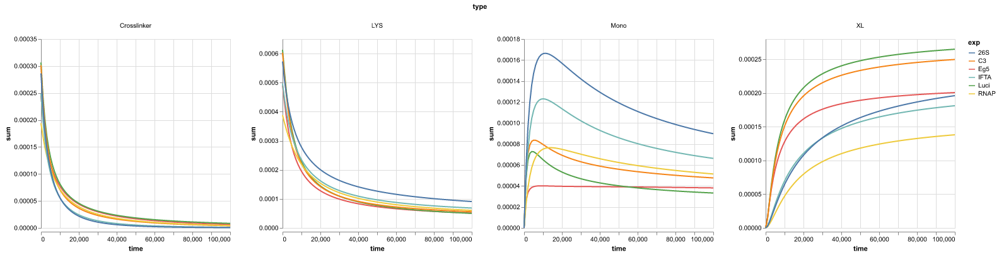

In [75]:
cf.get_val_plot_time(df_1d_timeline_no_hydro, fullmatch=True, species=f'{cf.str_species_lys}|{cf.str_species_mono_base}|{cf.str_species_crosslinked}|{cf.str_species_crosslinker}', column=cf.str_type, val_col=const.S_VALUE, metric='sum', show_variation=False)

All monolinks should be hydrolyzed. And how much of our overall yield is significant?

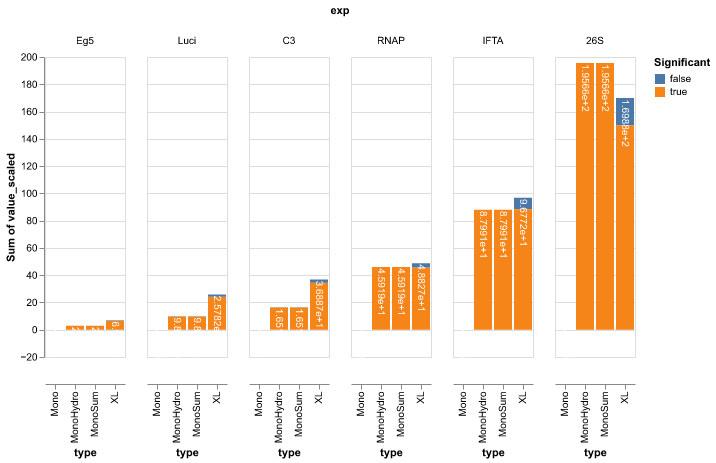

In [76]:
c = cf.get_val_sum_plot(df_1d_last_frame, species=f"{cf.str_species_mono_hydro}|{cf.str_species_mono_base}|{cf.str_species_mono_sum}|{cf.str_species_crosslinked}", min_val_abs=min_val, fullmatch=True, val_col=const.S_VALUE_SCALED)
c.save(f"{path_qc}/species_overall_scaled.png", scale_factor=2.0)
c

In [66]:
c = cf.get_connectivity_plot(df_1d_last_frame, min_val=min_val, val_col=const.S_VALUE_SCALED, show_chains=False)
c.save(f"{path_qc}/xl_connectivity.png", scale_factor=2.0)
c

alt.Chart(...)

In [74]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from 'C:\\Nextcloud-unikn\\Coding\\xlink_kme_sbml\\xlink_kme_sbml\\library\\sbml_sim_helper.py'>

In [38]:
list(df_1d_mono_only_last_frame[const.S_EXP].unique().sort_values())

['Eg5', 'Luci', 'C3', 'RNAP', 'IFTA', '26S']

### Correlation of Absolute Results

In [41]:
c = cf.get_corr_plot(df_1d_mono_only_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[const.S_EXP, cf.str_type], species=[const.S_REACT_MONO_SUM, const.S_REACT_XL], min_val_y=min_val, fit=False, name_x='Lysine Reactivity (1/s)', name_y='Mono-link Concentration (g/L)', axis_format='.1f')
c.save(f"{path_ar}/correlation_mono_only_model.png", scale_factor=2.0)
c.save(f"{path_ar}/correlation_mono_only_model.svg")
c

alt.Chart(...)

In [30]:
c = cf.get_corr_plot(df_1d_mono_only_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[cf.str_type], species=[const.S_REACT_MONO_SUM], min_val_y=min_val, fit=False, exp='C3', name_x='Lysine Reactivity (1/s)', name_y='Mono-link Concentration (g/L)', axis_format='.1f')
c.save(f"{path_ar}/correlation_C3_mono_only_model.svg", scale_factor=2.0)
c

alt.Chart(...)

In [22]:
# c = cf.get_corr_plot(df_melt_prot_mono_only_last_tp_tenth_xlinker, x=const.S_K_GENERIC, y=cf.str_value, group_by=[cf.str_type], species=[const.S_REACT_MONO_SUM, const.S_REACT_XL], min_val=min_abs_val_signi/10)
# c.save(f"{path_ar}/correlation_mono_only_model_reduced_xlinker.png", scale_factor=2.0)
# c

In [31]:
c = cf.get_corr_plot(df_1d_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[cf.str_type], species=[const.S_REACT_MONO_SUM, const.S_REACT_XL], min_val_y=min_val, fit=False, exp='C3', name_x='Lysine Reactivity (1/s)', name_y='Mono-link Concentration (g/L)', axis_format='.1f')
c.save(f"{path_ar}/correlation_C3.svg", scale_factor=2.0)
c

alt.FacetChart(...)

In [32]:
c = cf.get_corr_plot(df_1d_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[cf.str_type], species=[const.S_REACT_MONO_SUM], min_val_y=min_val, fit=False, exp='C3', name_x='Lysine Reactivity (1/s)', name_y='Mono-link Concentration (g/L)', axis_format='.1f')
c.save(f"{path_ar}/correlation_C3_xl_model_mono_only.svg", scale_factor=2.0)
c

alt.Chart(...)

In [34]:
c = cf.get_corr_plot(df_1d_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[cf.str_type], species=[const.S_REACT_XL], min_val_y=min_val, fit=False, exp='C3', name_x='Kinetic Distance (1/M*s)', name_y='Cross-link Concentration (g/L)', axis_format='.1e')
c.save(f"{path_ar}/correlation_C3_xl_model_xl_only.svg", scale_factor=2.0)
c

alt.Chart(...)

In [42]:
c.data

,time,variable,value,type,Protein1,Chain_ID1,Pos1,Protein2,Chain_ID2,Pos2,rate_const,value_scaled,exp,level_1,corr
0,10000000.0,XL_P01024_A_43_P01024_A_44,5.439028e-07,XL,P01024,A,43.0,P01024,A,44.0,4.059077e+08,0.100148,C3,rate_const,0.445098
1,10000000.0,XL_P01024_A_43_P01024_A_82,2.829125e-06,XL,P01024,A,43.0,P01024,A,82.0,9.889911e+08,0.520925,C3,rate_const,0.445098
2,10000000.0,XL_P01024_A_43_P01024_A_97,1.173607e-06,XL,P01024,A,43.0,P01024,A,97.0,5.947884e+08,0.216095,C3,rate_const,0.445098
3,10000000.0,XL_P01024_A_44_P01024_A_82,9.093736e-07,XL,P01024,A,44.0,P01024,A,82.0,6.282490e+08,0.167442,C3,rate_const,0.445098
4,10000000.0,XL_P01024_A_51_P01024_A_480,7.225946e-07,XL,P01024,A,51.0,P01024,A,480.0,1.291339e+08,0.133051,C3,rate_const,0.445098
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
205,10000000.0,XL_P01024_B_1567_P01024_B_1602,9.668473e-07,XL,P01024,B,1567.0,P01024,B,1602.0,9.770193e+08,0.178025,C3,rate_const,0.445098
206,10000000.0,XL_P01024_B_1573_P01024_B_1577,1.186566e-06,XL,P01024,B,1573.0,P01024,B,1577.0,8.269770e+08,0.218481,C3,rate_const,0.445098
207,10000000.0,XL_P01024_B_1573_P01024_B_1578,7.270361e-07,XL,P01024,B,1573.0,P01024,B,1578.0,5.013453e+08,0.133869,C3,rate_const,0.445098
208,10000000.0,XL_P01024_B_1573_P01024_B_1622,3.750924e-07,XL,P01024,B,1573.0,P01024,B,1622.0,2.503648e+08,0.069065,C3,rate_const,0.445098


In [40]:
c = cf.get_corr_plot(df_1d_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[const.S_EXP, cf.str_type], species=[const.S_REACT_MONO_SUM], min_val_y=min_val, fit=False, name_x='Lysine Reactivity (1/s)', name_y='Mono-link Concentration (g/L)', axis_format='.1f')
c.save(f"{path_ar}/correlation_xl_model_mono.svg")
c

alt.Chart(...)

In [39]:
c = cf.get_corr_plot(df_1d_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[const.S_EXP, cf.str_type], species=[const.S_REACT_XL], min_val_y=min_val, fit=False, name_x='Kinetic Distance (1/M*s)', name_y='Cross-link Concentration (g/L)', axis_format='.1e')
c.save(f"{path_ar}/correlation_xl_model_xl.svg")
c

alt.Chart(...)

In [ ]:
c = cf.get_corr_plot(df_1d_last_frame, x=const.S_K_GENERIC, y=const.S_VALUE_SCALED, group_by=[const.S_EXP, cf.str_type], species=[const.S_REACT_MONO_SUM, const.S_REACT_XL], min_val_y=min_val, fit=False, name_x='Lysine Reactivity (1/s)', name_y='Mono-link Concentration (g/L)', axis_format='.1f')
c.save(f"{path_ar}/correlation.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [25]:
# cf.get_corr_plot(df_melt_prot_last_tp_tenth_xlinker, x=const.S_K_GENERIC, y=cf.str_value, group_by=[cf.str_type], species=[const.S_REACT_MONO_SUM, const.S_REACT_XL], min_val=min_abs_val_signi/10)
# c.save(f"{path_ar}/correlation_reduced_xlinker.png", scale_factor=2.0)
# c

In [41]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from 'C:\\Nextcloud-unikn\\Coding\\xlink_kme_sbml\\xlink_kme_sbml\\library\\sbml_sim_helper.py'>

# General Parameter Effects

In [272]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_LYS], var=const.S_K_LYS, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE_SCALED) #ref_val_label=klys_median)
c.save(f"{path_gp}/explore_klys.png", scale_factor=2.0)
c

WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.


alt.FacetChart(...)

In [273]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_LYS], var=const.S_K_LYS, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE) #ref_val_label=klys_median)
c.save(f"{path_gp}/explore_klys_non_scaled.png", scale_factor=2.0)
c

WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.


alt.FacetChart(...)

In [274]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_ON_XL], var=const.S_K_ON_XL, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE_SCALED) #ref_val_label=kon_xl_median)
c.save(f"{path_gp}/explore_kon_xl.png", scale_factor=2.0)
c

WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.


alt.FacetChart(...)

In [275]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_LYS], var=const.S_LYS, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE_SCALED) #ref_val_label=lys_initial_conc)
c.save(f"{path_gp}/explore_conc_lys.png", scale_factor=2.0)
c

WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.


alt.FacetChart(...)

In [276]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_CROSSLINKER], var=cf.str_species_crosslinker, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE_SCALED, label_val='Mean Concentration (g/L)', label_var='Relative Crosslinker Concentration (g/L)')# ref_val_label=crosslinker_initial_amount)
c.save(f"{path_gp}/explore_xl.svg")
c.save(f"{path_gp}/explore_xl.png", scale_factor=2.0)
c

WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.


alt.FacetChart(...)

In [47]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_CROSSLINKER], var=cf.str_species_crosslinker, ref_val=1, min_val=0, metric='sum', val_col=const.S_VALUE)# ref_val_label=crosslinker_initial_amount)
c.save(f"{path_gp}/explore_xl_sum.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [48]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_CROSSLINKER], var=cf.str_species_crosslinker, ref_val=1, min_val=0, metric='sum', val_col=const.S_VALUE_SCALED)# ref_val_label=crosslinker_initial_amount)
c.save(f"{path_gp}/explore_xl_sum.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [49]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_CROSSLINKER], var=cf.str_species_crosslinker, ref_val=1, min_val=0, metric='sum', val_col=const.S_VALUE_SCALED)# ref_val_label=crosslinker_initial_amount)
c.save(f"{path_gp}/explore_xl_sum_scaled.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [50]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_CROSSLINKER], var=cf.str_species_crosslinker, ref_val=1, min_val=min_val, metric='count', val_col=const.S_VALUE_SCALED)# ref_val_label=crosslinker_initial_amount)
c.save(f"{path_gp}/explore_xl_count.png", scale_factor=2.0)
c

c:\Users\Don\mambaforge\envs\xl-kme-alt5\Lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

c:\Users\Don\mambaforge\envs\xl-kme-alt5\Lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [27]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from 'C:\\Nextcloud-unikn\\Coding\\xlink_kme_sbml\\xlink_kme_sbml\\library\\sbml_sim_helper.py'>

In [38]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_HYDROLYSIS], var=const.S_K_HYDROLYSIS, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE_SCALED, label_val='Mean Concentration (g/L)', label_var='Relative Hydrolysis Rate (1/s)')# ref_val_label=kh)
c.save(f"{path_gp}/explore_kh.svg")
c.save(f"{path_gp}/explore_kh.png", scale_factor=2.0)
c

WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.
WARN Dropping {} from channel "row" since it does not contain any data field, datum, value, or signal.


alt.FacetChart(...)

In [53]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_HYDROLYSIS], var=const.S_K_HYDROLYSIS, ref_val=1, min_val=min_val, metric='count', val_col=const.S_VALUE_SCALED)# ref_val_label=kh)
c.save(f"{path_gp}/explore_kh_count.png", scale_factor=2.0)
c

c:\Users\Don\mambaforge\envs\xl-kme-alt5\Lib\site-packages\numpy\core\_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

c:\Users\Don\mambaforge\envs\xl-kme-alt5\Lib\site-packages\numpy\core\_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [54]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_HYDROLYSIS], var=const.S_K_HYDROLYSIS, ref_val=1, min_val=0, metric='mean', val_col=const.S_VALUE_SCALED)# ref_val_label=kh)
c.save(f"{path_gp}/explore_kh_non_scaled.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [55]:
c = cf.get_explore_chart(df_dict_2d_concat[const.S_K_ON], var=const.S_K_ON, ref_val=1, x_axis_format='.1e', min_val=0, metric='mean', val_col=const.S_VALUE_SCALED) #ref_val_label=kon)
c.save(f"{path_gp}/explore_kon.png", scale_factor=2.0)
c

alt.FacetChart(...)

# 3D

In [43]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from 'C:\\Nextcloud-unikn\\Coding\\xlink_kme_sbml\\xlink_kme_sbml\\library\\sbml_sim_helper.py'>

In [38]:
c = cf.get_explore_chart_2d(get_3d_df_concat("Eg5", const.S_LYS, const.S_CROSSLINKER), x=const.S_LYS, y=const.S_CROSSLINKER, metric='count', format_y_scientific=False, ref_val_x=1, ref_val_y=1, min_val=0.05, val_col=const.S_VALUE_SCALED, axis_title_x='Relative Lysine Concentration (g/L)', axis_title_y='Relative Crosslinker Concentration (g/L)', legend_title='Count', format_x_scientific=False)#ref_val_label_y=crosslinker_initial_amount, ref_val_label_x=lys_initial_conc)
c.save(f"{path_surface}/conc_eg5_lys_xl_count.svg")
c

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [35]:
c = cf.get_explore_chart_2d(get_3d_df_concat("Luci", const.S_LYS, const.S_CROSSLINKER), x=const.S_LYS, y=const.S_CROSSLINKER, metric='count', format_y_scientific=False, ref_val_x=1, ref_val_y=1, min_val=0.05, val_col=const.S_VALUE_SCALED, axis_title_x='Relative Lysine Concentration (g/L)', axis_title_y='Relative Crosslinker Concentration (g/L)', legend_title='Count', format_x_scientific=False)#ref_val_label_y=crosslinker_initial_amount, ref_val_label_x=lys_initial_conc)
c.save(f"{path_surface}/conc_luci_lys_xl_count.svg")
c

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [34]:
c = cf.get_explore_chart_2d(get_3d_df_concat("C3", const.S_LYS, const.S_CROSSLINKER), x=const.S_LYS, y=const.S_CROSSLINKER, metric='count', format_y_scientific=False, ref_val_x=1, ref_val_y=1, min_val=0.05, val_col=const.S_VALUE_SCALED, axis_title_x='Relative Lysine Concentration (g/L)', axis_title_y='Relative Crosslinker Concentration (g/L)', legend_title='Count', format_x_scientific=False)#ref_val_label_y=crosslinker_initial_amount, ref_val_label_x=lys_initial_conc)
c.save(f"{path_surface}/conc_c3_lys_xl_count.svg")
c

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [37]:
c = cf.get_explore_chart_2d(get_3d_df_concat("Eg5", const.S_K_HYDROLYSIS, const.S_CROSSLINKER), x=const.S_K_HYDROLYSIS, y=const.S_CROSSLINKER, metric='count', format_y_scientific=False, ref_val_x=1, ref_val_y=1, min_val=0.05, val_col=const.S_VALUE_SCALED, axis_title_x='Relative Hydrolysis Rate (1/s)', axis_title_y='Relative Crosslinker Concentration (g/L)', legend_title='Count', format_x_scientific=False)#ref_val_label_y=crosslinker_initial_amount, ref_val_label_x=lys_initial_conc)
c.save(f"{path_surface}/conc_eg5_xl_kh_count.svg")
c

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [32]:
c = cf.get_explore_chart_2d(get_3d_df_concat("Luci", const.S_K_HYDROLYSIS, const.S_CROSSLINKER), x=const.S_K_HYDROLYSIS, y=const.S_CROSSLINKER, metric='count', format_y_scientific=False, ref_val_x=1, ref_val_y=1, min_val=0.05, val_col=const.S_VALUE_SCALED, axis_title_x='Relative Hydrolysis Rate (1/s)', axis_title_y='Relative Crosslinker Concentration (g/L)', legend_title='Count', format_x_scientific=False)#ref_val_label_y=crosslinker_initial_amount, ref_val_label_x=lys_initial_conc)
c.save(f"{path_surface}/conc_luci_xl_kh_count.svg")
c

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

In [31]:
c = cf.get_explore_chart_2d(get_3d_df_concat("C3", const.S_K_HYDROLYSIS, const.S_CROSSLINKER), x=const.S_K_HYDROLYSIS, y=const.S_CROSSLINKER, metric='count', format_y_scientific=False, ref_val_x=1, ref_val_y=1, min_val=0.05, val_col=const.S_VALUE_SCALED, axis_title_x='Relative Hydrolysis Rate (1/s)', axis_title_y='Relative Crosslinker Concentration (g/L)', legend_title='Count', format_x_scientific=False)#ref_val_label_y=crosslinker_initial_amount, ref_val_label_x=lys_initial_conc)
c.save(f"{path_surface}/conc_c3_xl_kh_count.svg")
c

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:269: RuntimeWarning:

Degrees of freedom <= 0 for slice

/opt/miniconda3/envs/xl-kme-alt5/lib/python3.11/site-packages/numpy/core/_methods.py:261: RuntimeWarning:

invalid value encountered in scalar divide



alt.FacetChart(...)

# Suppression Experiment

In [130]:
df_supp_klys_eg5 = df_supp_klys[df_supp_klys[const.S_EXP] == 'Eg5'].copy()

In [236]:
# reload python libs on the without restarting the kernel
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)


<module 'xlink_kme_sbml.library.sbml_sim_helper' from '/home/kai/Nextcloud-unikn/Coding/xlink_kme_sbml/xlink_kme_sbml/library/sbml_sim_helper.py'>

In [279]:
c = cf.get_signi_plot_rr(df_supp_klys_eg5, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5, y_label='Significant Changes')
c.save(f"{path_se}/overview_significance.png", scale_factor=2.0)
c

WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.


alt.LayerChart(...)

In [280]:
c = cf.get_signi_plot_rr(df_supp_klys_eg5, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5, exclude_imputed=True, y_label='No. of Significant Changes')
c.save(f"{path_se}/overview_significance_exclude_imputed.svg")
c.save(f"{path_se}/overview_significance_exclude_imputed.png", scale_factor=2.0)
c

WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.
WARN Invalid field type "nominal" for aggregate: "count", using "quantitative" instead.


alt.LayerChart(...)

In [281]:
c = cf.get_suppress_plot(df_supp_klys_eg5, col='cond', var_col=cf.str_var, val_col=cf.str_value_change, color=cf.str_type, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5)
c.save(f"{path_se}/suppression_overview.png", scale_factor=1.0)
c

alt.FacetChart(...)

In [150]:
c = cf.get_suppress_plot(df_supp_klys_eg5, col='cond', var_col=cf.str_var, val_col=const.S_LOG2RATIO, color=cf.str_type, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5, exclude_imputed=True)
c.save(f"{path_se}/suppression_overview_log2_exclude_imputed.png", scale_factor=2.0)
c

alt.FacetChart(...)

## Single Suppressions in Detail

In [256]:
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from '/home/kai/Nextcloud-unikn/Coding/xlink_kme_sbml/xlink_kme_sbml/library/sbml_sim_helper.py'>

In [155]:
# df_single_supp = cf.filter_species_min_val(df_supp_klys_eg5[df_supp_klys_eg5[cf.str_cond] == 'S: A_146'], val_col=cf.str_value_change, min_val=0.05)
df_single_supp_change = cf.get_chimerax_supp_df(df_supp_klys_eg5, cond=f'S: A_146', val_col=cf.str_value_change, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5)
df_single_supp_log2 = cf.get_chimerax_supp_df(df_supp_klys_eg5, cond=f'S: A_146', val_col=const.S_LOG2RATIO, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5)

In [156]:
c = cf.get_single_supp_plot(df_single_supp_change, var_col=cf.str_var, val_col=cf.str_value_change)
c.save(f"{path_se}/suppression_single_view_146.png", scale_factor=2.0)
c

alt.FacetChart(...)

In [257]:
c = cf.get_single_supp_plot(df_single_supp_log2, var_col=cf.str_var, val_col=const.S_LOG2RATIO)
c.save(f"{path_se}/suppression_single_view_146_log2.svg")
c.save(f"{path_se}/suppression_single_view_146_log2.png", scale_factor=2.0)
c

alt.FacetChart(...)

# ChimeraX Output

In [209]:
importlib.reload(cf)
importlib.reload(const)
importlib.reload(sbml_sim_helper)

<module 'xlink_kme_sbml.library.sbml_sim_helper' from '/home/kai/Nextcloud-unikn/Coding/xlink_kme_sbml/xlink_kme_sbml/library/sbml_sim_helper.py'>

In [211]:
exp_name_to_pdb_id = {'Eg5': '3wpn', 'C3': '2a73', '26S': '4cr2', 'Luci': '4g36', 'RNAP': '6drd', 'IFTA': '8fgw'}

## Absolute values

In [212]:
for exp, pdb_id in exp_name_to_pdb_id.items():
    df_in = cf.filter_species_min_val(df_1d_last_frame[df_1d_last_frame[const.S_EXP] == exp], val_col=const.S_VALUE_SCALED, min_val=0.05)
    df_tmp = cf.get_continous_color_scale(df_in, val_col=cf.str_value, different_color_scale_mono_xl=False)
    out_list = cf.get_chimerax_xl_color_script(df_tmp, pdb_id)
    with open(f"{path_chx}/color_{exp}_{pdb_id}.py", "w") as file:
        file.writelines(out_list)

## Suppression Experiment

In [198]:
pdb_id = "3wpn" #Eg5
detailed_condition_chain = "A"
detailed_condition_pos = 146
detailed_condition_string = f"{detailed_condition_chain}_{detailed_condition_pos}"

In [199]:
df_c = cf.get_chimerax_supp_df(df_supp_klys_eg5, cond=f'S: {detailed_condition_string}', val_col=const.S_LOG2RATIO, min_val_abs=0.0, min_inc_abs=0.05, min_log2ratio_abs=0.5)


In [207]:
out_supp = cf.get_chimerax_xl_color_script(df_c, pdb_id=pdb_id, supp_pos=detailed_condition_pos, supp_chain=detailed_condition_chain)
with open(f"{path_chx}/color_{pdb_id}_supp_{detailed_condition_string}.py", "w") as file:
    file.writelines(out_supp)

In [201]:
df_c

,time,variable,value_ref,type,Protein1,Chain_ID1,Pos1,Protein2,Chain_ID2,Pos2,...,log2ratio_scaled,Significant_min_val_abs,Significant_min_log2ratio,Significant_min_inc_abs,reason_non_signi,Significant,log2ratio_sign,base_color,log2ratio_norm,hsl_color
87,10000000.0,XL_A_146_A_207,6.812780e-06,XL,P52732,A,146,P52732,A,207,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,-,240,0.61,"(240, 0.61, 0.5)"
88,10000000.0,XL_A_146_A_246,4.061992e-06,XL,P52732,A,146,P52732,A,246,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,-,240,0.20,"(240, 0.2, 0.5)"
89,10000000.0,XL_A_146_A_257,1.105718e-05,XL,P52732,A,146,P52732,A,257,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,-,240,1.00,"(240, 1.0, 0.5)"
111,10000000.0,XL_A_246_A_257,1.255838e-06,XL,P52732,A,246,P52732,A,257,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,+,0,1.00,"(0, 1.0, 0.5)"
115,10000000.0,XL_A_257_A_362,8.844414e-07,XL,P52732,A,257,P52732,A,362,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,+,0,0.55,"(0, 0.55, 0.5)"
116,10000000.0,XL_A_257_A_368,2.830886e-06,XL,P52732,A,257,P52732,A,368,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,+,0,0.20,"(0, 0.2, 0.5)"
121,10000000.0,MonoSum_A_146,1.174550e-06,MonoSum,P52732,A,146,NaN,NaN,0,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,-,240,1.00,"(240, 1.0, 0.5)"
127,10000000.0,MonoSum_A_207,7.086734e-06,MonoSum,P52732,A,207,NaN,NaN,0,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,+,0,0.20,"(0, 0.2, 0.5)"
131,10000000.0,MonoSum_A_257,2.166215e-06,MonoSum,P52732,A,257,NaN,NaN,0,...,NaN,True,True,True,"Significant_min_val_abs: True, Significant_min...",True,+,0,1.00,"(0, 1.0, 0.5)"
